In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import time

In [2]:
lk_params = dict(winSize  = (10, 10),
                maxLevel = 3,
                criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

feature_params = dict(maxCorners = 80,
                    qualityLevel = 0.2,
                    minDistance = 40,
                    blockSize = 7 )


trajectory_len = 200  #40
detect_interval = 1  #
trajectories = []
frame_idx = 0


In [4]:
cap = cv2.VideoCapture('2.mp4')


while True:
    frameTime = 10

    # start time to calculate FPS
    start = time.time()

    suc, frame = cap.read()
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    img = frame.copy()
    operatedImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) #convert BGR image to grayscale.
    operatedImage = np.float32(operatedImage) #convert image into float type.
    dest = cv2.cornerHarris(operatedImage, 2, 7, 0.07) #apply harris corner detection on new float image for bloacksize of 2, kernel of 5x5 and and 0.07 value of harris free paramter.  
    dest = cv2.dilate(dest, None) #dilate: reducing the thicknes of egdes 

    # Calculate optical flow for a sparse feature set using the iterative Lucas-Kanade Method
    if len(trajectories) > 0:
        img0, img1 = prev_gray, frame_gray
        p0 = np.float32([trajectory[-1] for trajectory in trajectories]).reshape(-1, 1, 2)
        p1, _st, _err = cv2.calcOpticalFlowPyrLK(img0, img1, p0, None, **lk_params)
        p0r, _st, _err = cv2.calcOpticalFlowPyrLK(img1, img0, p1, None, **lk_params)
        d = abs(p0-p0r).reshape(-1, 2).max(-1)
        good = d < 1

        new_trajectories = []

        # Get all the trajectories
        for trajectory, (x, y), good_flag in zip(trajectories, p1.reshape(-1, 2), good):
            if not good_flag:
                continue
            trajectory.append((x, y))
            if len(trajectory) > trajectory_len:
                del trajectory[0]
            new_trajectories.append(trajectory)
            # Newest detected point
            cv2.circle(img, (int(x), int(y)), 2, (0, 0, 255), -1)

        trajectories = new_trajectories

        # Draw all the trajectories
        cv2.polylines(img, [np.int32(trajectory) for trajectory in trajectories], False, (0, 255, 0),1)
        cv2.putText(img, 'track count: %d' % len(trajectories), (20, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2)


    # Update interval - When to update and detect new features
    if frame_idx % detect_interval == 0:
        mask = np.zeros_like(frame_gray)
        mask[:] = 255

        # Lastest point in latest trajectory
        for x, y in [np.int32(trajectory[-1]) for trajectory in trajectories]:
            cv2.circle(mask, (x, y), 5, 0, -1)

        # Detect the good features to track
        p = cv2.goodFeaturesToTrack(frame_gray, mask = mask, **feature_params)
        if p is not None:
            # If good features can be tracked - add that to the trajectories
            for x, y in np.float32(p).reshape(-1, 2):
                trajectories.append([(x, y)])


    frame_idx += 1
    prev_gray = frame_gray

    # End time
    end = time.time()+0.001
    # calculate the FPS for current frame detection
    fps = 1 / (end-start)
    
    # Show Results
    cv2.putText(img, f"{fps:.2f} FPS", (20, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.imshow('Optical Flow', img)
    cv2.imshow('Mask', mask)
    
    print(trajectories)

    if cv2.waitKey(100) & 0xFF == ord('q'):
        break


cap.release()
cv2.destroyAllWindows()


[[(148.0, 148.0), (147.99138, 148.241), (147.9931, 148.49895), (147.9922, 148.75409), (147.9943, 148.98116), (147.99083, 149.23358), (147.88208, 149.48076), (147.76955, 149.68361), (147.71964, 149.82028), (147.6876, 149.98102), (147.64218, 149.98549), (147.59392, 149.98534), (147.55083, 150.00467), (147.51997, 150.0161), (147.51785, 150.01213), (147.095, 149.79366), (147.38806, 149.72725), (146.89337, 149.93855), (146.76599, 149.954), (146.64296, 149.95248), (146.84215, 149.77281), (146.59097, 149.74918), (146.38326, 149.64009), (146.19456, 149.4641), (146.07333, 149.47685), (145.9523, 149.47113), (145.7419, 149.42598), (145.74756, 149.41803), (145.6191, 149.23253), (145.52705, 149.12112), (145.33305, 148.85555), (145.30469, 148.80547), (145.25963, 148.97992), (145.16669, 148.91782), (145.08435, 148.85205), (145.0539, 148.81738), (145.06902, 148.7592), (145.069, 148.75928), (145.03436, 148.79756), (145.02756, 148.79622), (145.02612, 148.79333), (145.01314, 148.80133), (145.08092, 148.9

In [11]:
import cv2
import numpy as np

# Load image
img = cv2.imread('cp1.jpeg')

# Convert image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to remove noise
blur = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply Canny edge detection to find edges
edges = cv2.Canny(blur, 50, 150, apertureSize=3)

# Find lines using Hough transform
lines = cv2.HoughLines(edges, 1, np.pi/180, 100)

# Draw lines on original image
if lines is not None:
    for line in lines:
        rho, theta = line[0]
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        x1 = int(x0 + 1000 * (-b))
        y1 = int(y0 + 1000 * (a))
        x2 = int(x0 - 1000 * (-b))
        y2 = int(y0 - 1000 * (a))
        cv2.line(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

# Show image
cv2.imshow('image', img)
cv2.waitKey(0)
cv2.destroyAllWindows()


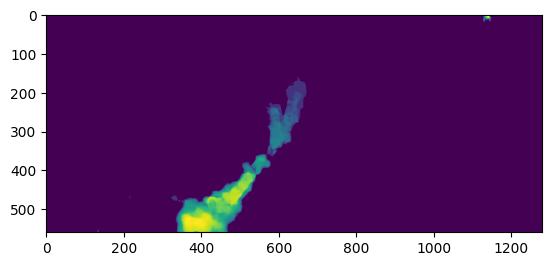

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image in grayscale
img = cv2.imread('D:/TY/CVLAB/cpds/optical_flow_images/back_0080.png', 0)

# Calculate the histogram
hist, bins = np.histogram(img.flatten(), 256, [0, 256])

# Calculate the normalized CDF
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max() / cdf.max()

# Map the pixel values to their new values based on the normalized CDF
img_normalized = np.interp(img.flatten(), bins[:-1], cdf_normalized)
img_normalized = img_normalized.reshape(img.shape)

# Save the normalized image
# cv2.imshow()
plt.imshow(img_normalized)


In [10]:
import cv2
import numpy as np

# Load the image
img = cv2.imread('D:/TY/CVLAB/cpds/optical_flow_images/back_0080.png')

# Convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Compute the HOG descriptor
winSize = (64, 128) # window size
blockSize = (16, 16) # block size
blockStride = (8, 8) # block stride
cellSize = (8, 8) # cell size
nbins = 10 # number of bins

hog = cv2.HOGDescriptor(winSize, blockSize, blockStride, cellSize, nbins)
hog_features = hog.compute(gray)

# Reshape the HOG features
hog_features = hog_features.flatten()

# Normalize the HOG features
hog_features /= np.linalg.norm(hog_features)

# Print the shape of the HOG features array
print(np.size(np.unique(hog_features)))


17696


In [1]:
import cv2
import numpy as np
from skimage.feature import hog


def extract_hog_features(image):
    # define the HOG parameters
    orientations = 9
    pixels_per_cell = (16, 16)
    cells_per_block = (2, 2)
    
    # compute the HOG features for the image
    features = hog(image, orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, visualize=False, transform_sqrt=True)
    print('\n')
    # return the features as a 1D NumPy array
    return features.ravel()

In [35]:
import cv2
import numpy as np
from skimage.feature import hog

# Load the image
img = cv2.imread('D:/TY/CVLAB/cpds/optical_flow_images/down_0010.png')

# Convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

q=[]
h=extract_hog_features(gray)
for i in h:
    if  i>0.0 and i<0.1:
        q.append(i)


print(np.shape(q))
print(np.sum(h))
print(np.mean(h))
print(np.std(h))
print(np.var(h))






(0,)
5682.104614963474
0.05876256117071517
0.12292393543418961
0.015110293902628818


In [7]:
print(np.shape(h))

(96696,)


In [9]:
u = np.unique(h)
np.shape(u)

(3276,)

In [12]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Load the data from the CSV file
data = pd.read_csv('./cpds/base_1.csv', on_bad_lines='skip')
# Select only the columns containing the data (exclude any header or label columns)
data = data.fillna(0)

# # Normalize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(data)

# # Perform PCA with n_components set to the number of components you want to keep
n_components = 20
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)

# # Create a new dataframe with only the principal components
pca_df = pd.DataFrame(data = principal_components, columns = ['PC{}'.format(i) for i in range(1,21)])

# # Save the principal components to a new CSV file
pca_df.to_csv('./cpds/pca_output.csv', index=False)


ValueError: n_components=20 must be between 0 and min(n_samples, n_features)=14 with svd_solver='full'

In [3]:
import pandas as pd
csv_file_path = './cpds/base_1.csv'
df = pd.read_csv(csv_file_path)
# Load the data into a NumPy array
row=df.iloc[1,:]
print(row)
scaler = StandardScaler()
data_scaled = scaler.fit_transform(row)
# Perform PCA with n_components set to the number of components you want to keep
n_components = 20
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(data_scaled)
# Replace the original data with the principal components
print(principal_components)



ParserError: Error tokenizing data. C error: Expected 128824 fields in line 3, saw 140527


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")


m_data = pd.read_csv('./cpds/base_1.csv', on_bad_lines='skip')

# Machine learning systems work with integers, we need to encode these
# string characters into ints

encoder = LabelEncoder()

# Now apply the transformation to all the columns:
for col in m_data.columns:
    m_data[col] = encoder.fit_transform(m_data[col])

X_features = m_data.iloc[:,1:23]
y_label = m_data.iloc[:, 0]

# Scale the features
scaler = StandardScaler()
X_features = scaler.fit_transform(X_features)

# Visualize
pca = PCA()
pca.fit_transform(X_features)
pca_variance = pca.explained_variance_
print(pca_variance)

[1.30150463e+001 3.08394151e-029 6.15959318e-057 1.21622899e-086
 1.43765004e-114 8.43300925e-144 1.88324731e-170 2.53175989e-176
 3.50770293e-199 1.06596657e-202 6.91389066e-204 1.17621552e-210
 1.05188833e-237]


In [ ]:
import pandas as pd

# Read CSV file into pandas DataFrame
df = pd.read_csv("filename.csv")

# Replace all NaN values with 0
df = df.fillna(0)

# Save modified DataFrame back to CSV file
df.to_csv("filename.csv", index=False)


In [1]:
import numpy as np
import pandas as pd
import os
import csv
import cv2
from matplotlib import pyplot as plt

from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.tree import DecisionTreeClassifier
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score

In [ ]:
img = cv2.imread('./penguin.jpg',0)

# Initiate SIFT detector
sift = cv2.SIFT_create(nfeatures=1000)

# find the keypoints with SIFT
keypoints = sift.detect(img,None)

# compute the descriptors with SIFT
keypoints, descriptors = sift.compute(img, keypoints)

# draw only keypoints location,not size and orientation
img2 = cv2.drawKeypoints(img,keypoints,descriptors, color=(0,255,0), flags=0, )
plt.imshow(img2),plt.show()

print ("No of keypoints :" , len(keypoints))
print ("length of descriptor:" , len(descriptors))
print ("length of descripbed keypoint:" , len(descriptors[1])) 
print ("Elements stored in descriptor" , descriptors[0])


In [13]:
import cv2
import numpy as np

# Open the video file
video = cv2.VideoCapture('D:/TY/CVLAB/cpds/down_009.mp4')

# Loop through the video frame by frame
while True:
    # Read the current frame
    ret, img = video.read()

    # If the video has ended, break out of the loop
    if not ret:
        break

    # Display the current frame
    # cv2.imshow('Video', frame)

    sift = cv2.SIFT_create(nfeatures=1000)

    # find the keypoints with SIFT
    keypoints = sift.detect(img,None)

    # compute the descriptors with SIFT
    keypoints, descriptors = sift.compute(img, keypoints)
    print(np.shape(descriptors))

    # draw only keypoints location,not size and orientation
    img2 = cv2.drawKeypoints(img,keypoints,descriptors, color=(0,255,0), flags=0, )
    cv2.imshow('Video', img2)

    # Wait for a key press (time delay can be adjusted)
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

# Release the video file and close all windows
video.release()
cv2.destroyAllWindows()


(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1001, 128)
(1000, 128)
(1000, 128)
(1000, 128)
(1000, 128)


In [1]:
import cv2
import pandas as pd
import numpy as np
import os
import joblib
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn import preprocessing
from skimage.filters import sobel
from skimage.feature import graycomatrix, graycoprops
from skimage.measure import shannon_entropy
import warnings
warnings.filterwarnings('ignore')

In [13]:
import cv2
import os

# Define the folder path containing the videos
folder_path = './cpds/dataset/down/'
count = 0

# Loop through each file in the folder
for filename in os.listdir(folder_path):
    # Check if the file is a video
    if filename.endswith('.mp4') or filename.endswith('.avi'):
        # Define the path to the video file
        video_path = os.path.join(folder_path, filename)
        
        # Open the video file
        cap = cv2.VideoCapture(video_path)

        # Initialize frame count

        # Loop through the video and save each frame as an image
        while(cap.isOpened()):
            # Read the current frame
            ret, frame = cap.read()

            # If the frame was successfully read, save it as an image
            if ret == True:
                # Define the path to save the image
                image_path = os.path.join(folder_path, 'frames', str(count) + '.jpg')
                print(image_path)
                # Save the image
                cv2.imwrite(image_path, frame)

                # Increment the frame count
                count += 1
            else:
                break

        # Release the video capture object
        cap.release()

print('Done converting videos to frames!')


./cpds/dataset/down/frames\0.jpg
./cpds/dataset/down/frames\1.jpg
./cpds/dataset/down/frames\2.jpg
./cpds/dataset/down/frames\3.jpg
./cpds/dataset/down/frames\4.jpg
./cpds/dataset/down/frames\5.jpg
./cpds/dataset/down/frames\6.jpg
./cpds/dataset/down/frames\7.jpg
./cpds/dataset/down/frames\8.jpg
./cpds/dataset/down/frames\9.jpg
./cpds/dataset/down/frames\10.jpg
./cpds/dataset/down/frames\11.jpg
./cpds/dataset/down/frames\12.jpg
./cpds/dataset/down/frames\13.jpg
./cpds/dataset/down/frames\14.jpg
./cpds/dataset/down/frames\15.jpg
./cpds/dataset/down/frames\16.jpg
./cpds/dataset/down/frames\17.jpg
./cpds/dataset/down/frames\18.jpg
./cpds/dataset/down/frames\19.jpg
./cpds/dataset/down/frames\20.jpg
./cpds/dataset/down/frames\21.jpg
./cpds/dataset/down/frames\22.jpg
./cpds/dataset/down/frames\23.jpg
./cpds/dataset/down/frames\24.jpg
./cpds/dataset/down/frames\25.jpg
./cpds/dataset/down/frames\26.jpg
./cpds/dataset/down/frames\27.jpg
./cpds/dataset/down/frames\28.jpg
./cpds/dataset/down/fram

In [2]:
input0 = './cpds/dataset/'
temp = ['back', 'down', 'follow']

In [19]:
#cleanup.clean('SIFT')
for i in temp:
    count = 0
    for filename in os.listdir(input0 + i + "/frames"):
        img = cv2.imread(input0 + i + '/frames' + '/' + filename)
        print(input0 + i + '/frames' + '/' + filename)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        #initialise sift descriptor
        sift = cv2.SIFT_create(nfeatures=100)
        keypoints, descriptors = sift.detectAndCompute(gray, None)

        # sift_image = cv2.drawKeypoints(gray, keypoints, img)
        # try:
        descriptors = descriptors.reshape(1, -1)
        descriptors = descriptors[:,:256]
        # except:
        #     descriptors = np.zeros(1536)
        #convert the descriptor array into a dataframe format
        out=pd.DataFrame(descriptors)
        print("descriptor shape ",i," : ", out.shape)
        #append to the csv file
        
        csv_data=out.to_csv('./cpds/SIFT_' + i + '.csv', mode='a', index=False)
        count += 1
        if count == 1000:
            break
    print(i + ": " + str(count))
    

./cpds/dataset/back/frames/back_0003.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0005.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0007.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0009.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0011.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0013.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0015.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0017.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0019.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0021.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0023.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0025.png
descriptor shape  back  :  (1, 256)
./cpds/dataset/back/frames/back_0027.png
descriptor shape  back  :  (1, 256)

In [20]:
data1 = pd.read_csv('./cpds/SIFT_back.csv', dtype='float64')
data2 = pd.read_csv('./cpds/SIFT_down.csv', dtype='float64')
data3 = pd.read_csv('./cpds/SIFT_follow.csv', dtype='float64')

In [21]:
data1 = data1.fillna(0)
data2 = data2.fillna(0)
data3 = data3.fillna(0)


In [22]:
data3

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,26.0,5.0,1.0,2.0,0.0,0.0,0.0,7.0,109.0,63.0,...,32.0,27.0,0.0,0.0,0.0,0.0,1.0,5.0,0.0,2.0
1,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,...,246.0,247.0,248.0,249.0,250.0,251.0,252.0,253.0,254.0,255.0
2,71.0,102.0,44.0,2.0,1.0,4.0,9.0,23.0,4.0,21.0,...,32.0,17.0,11.0,41.0,15.0,39.0,48.0,28.0,5.0,0.0
3,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,...,246.0,247.0,248.0,249.0,250.0,251.0,252.0,253.0,254.0,255.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
336,1.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
337,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,...,246.0,247.0,248.0,249.0,250.0,251.0,252.0,253.0,254.0,255.0
338,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,5.0,1.0,0.0,0.0,0.0
339,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,...,246.0,247.0,248.0,249.0,250.0,251.0,252.0,253.0,254.0,255.0


In [61]:
kmeans1 = KMeans(n_clusters=5)
kmeans1.fit(data1)

kmeans2 = KMeans(n_clusters=5)
kmeans2.fit(data2)

kmeans3 = KMeans(n_clusters=5)
kmeans3.fit(data3)


KMeans(n_clusters=5)

In [11]:
data1 = data1.astype('uint8')
data2 = data2.astype('uint8')
data3 = data3.astype('uint8')

In [23]:


kmeans4 = KMeans(n_clusters=5)
kmeans4.fit(data1.append(data2.append(data3)))

joblib.dump(kmeans4, './cpds/SIFT_kmeans/1.txt')

['./cpds/SIFT_kmeans/1.txt']

In [25]:
c = 0
for i in temp:
    data = []
    path_to_folder = input0+i+"/frames"
    print(path_to_folder)
    for fname in os.listdir(path_to_folder):
        path_to_file = path_to_folder+'/'+fname
        img = cv2.imread(path_to_file)
        sift = cv2.SIFT_create(nfeatures=10)
        keypoints, descriptors = sift.detectAndCompute(img, None)
        # descriptors=descriptors.fillna(0)
        descriptors=descriptors.reshape(1,-1)
        descriptors = descriptors[:,:256]
        out1 = pd.DataFrame(descriptors)
        array_double = np.array(out1, dtype=np.double)
        a=kmeans4.predict(array_double)
        hist=np.histogram(a,bins=5)  #the range of 10 cluster assignments is divided into 6 intervals.
        data.append(hist[0])
        # csv_data = out1.to_csv(r'SIFT\SIFT_{}.csv'.format(i), mode='a', index=False)
    Output = pd.DataFrame(data)
    Output["Class"] = c
    csv_data=Output.to_csv(r'./cpds/SIFT_Final_{}.csv'.format(i), mode='a', index=False)
    c += 1

./cpds/dataset/back/frames
./cpds/dataset/down/frames
./cpds/dataset/follow/frames


In [26]:
out1

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0


In [27]:
data 

[array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0, 1, 0, 0], dtype=int64),
 array([0, 0

In [28]:
Output

,0,1,2,3,4,Class
0,0,0,1,0,0,2
1,0,0,1,0,0,2
2,0,0,1,0,0,2
3,0,0,1,0,0,2
4,0,0,1,0,0,2
...,...,...,...,...,...,...
166,0,0,1,0,0,2
167,0,0,1,0,0,2
168,0,0,1,0,0,2
169,0,0,1,0,0,2


In [4]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Read CSV file into a Pandas DataFrame
df = pd.read_csv('./cpds/test1.csv')

# Define the columns to be normalized
cols_to_norm = ['Mean', 'Standard Deviation', 'Variance', 'Bin 5', 'Bin 6','Bin 7', 'Bin 8','Bin 9','Sum HOG', 'Mean HOG', 'Standard Deviation HOG', 'HOG Hist 0', 'HOG Hist 1', 'HOG Hist 2', 'HOG Hist 3', 'HOG Hist 4', 'HOG Hist 5','HOG Hist 6','HOG Hist 7','HOG Hist 8','HOG Hist 9']

# Create a scaler object
scaler = MinMaxScaler()

# Normalize the selected columns using the scaler
df[cols_to_norm] = scaler.fit_transform(df[cols_to_norm])

df.to_csv('./cpds/test1.csv', index=False)

# Display the normalized DataFrame
print(df)


          Mean  Standard Deviation  Variance   Label  Bin 0  Bin 1  Bin 2  \
0     0.086395            0.296581  0.119031    back      0      0      0   
1     0.050625            0.173118  0.051290    back      0      0      0   
2     0.119815            0.248251  0.089423    back      0      0      0   
3     0.129642            0.341006  0.149754    back      0      0      0   
4     0.060640            0.208397  0.067999    back      0      0      0   
...        ...                 ...       ...     ...    ...    ...    ...   
1053  0.230066            0.320413  0.135095  follow      0      0      0   
1054  0.124572            0.198407  0.063052  follow      0      0      0   
1055  0.160668            0.201009  0.064324  follow      0      0      0   
1056  0.119285            0.169203  0.049566  follow      0      0      0   
1057  0.386801            0.371797  0.173019  follow      0      0      0   

      Bin 3  Bin 4     Bin 5  ...  HOG Hist 0  HOG Hist 1  HOG Hist 2  \
0 

In [5]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Read CSV file into a Pandas DataFrame
df = pd.read_csv('./cpds/test2.csv')

# Define the columns to be normalized
cols_to_norm = ['SIFT {}'.format(i) for i in range(0,128)]

# Create a scaler object
scaler = MinMaxScaler()

# Normalize the selected columns using the scaler
df[cols_to_norm] = scaler.fit_transform(df[cols_to_norm])

df.to_csv('./cpds/test2.csv', index=False)

# Display the normalized DataFrame
print(df)


        SIFT 0    SIFT 1    SIFT 2    SIFT 3    SIFT 4    SIFT 5    SIFT 6  \
0     0.866106  0.632695  0.461859  0.449646  0.549696  0.380122  0.466683   
1     0.610998  0.351353  0.403890  0.703854  0.434921  0.662251  0.280480   
2     0.489854  0.386070  0.580198  0.564362  0.422432  0.535476  0.368421   
3     0.604521  0.361964  0.545194  0.603571  0.408072  0.278031  0.511354   
4     0.601887  0.452448  0.593554  0.625858  0.382814  0.494532  0.723068   
...        ...       ...       ...       ...       ...       ...       ...   
1053  0.579201  0.480422  0.400291  0.560080  0.737868  0.522182  0.526370   
1054  0.545510  0.462191  0.614856  0.390300  0.414835  0.538223  0.435255   
1055  0.554743  0.598361  0.572004  0.601054  0.408230  0.531984  0.379482   
1056  0.541040  0.457218  0.336172  0.560201  0.707961  0.501126  0.371671   
1057  0.459604  0.489164  0.570025  0.486173  0.726231  0.540978  0.285900   

        SIFT 7    SIFT 8    SIFT 9  ...  SIFT 118  SIFT 119  SI

REpeat

In [7]:
import pandas as pd
import csv

# Define the paths to the CSV files
csv_path_1 = "./cpds/test1.csv"
csv_path_2 = "./cpds/test2.csv"

# Read the CSV files into separate pandas DataFrames
df1 = pd.read_csv(csv_path_1)
df2 = pd.read_csv(csv_path_2)
# print(df1.columns.tolist())
# print(df2.columns.tolist())
# print(df1.loc[0].tolist()+df2.loc[0].tolist())
csv_file_path = './cpds/testfeatures.csv'
with open(csv_file_path, 'w', newline='') as file:
    writer = csv.writer(file)

    header = df1.columns.tolist()+df2.columns.tolist()
    writer.writerow(header)
    row=[]
    for i in range(1058):
        row=df1.loc[i].tolist()+df2.loc[i].tolist()
        writer.writerow(row)

In [28]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

# Load the CSV file with extracted features
csv_file_path = './cpds/testfeatures2.csv'
df = pd.read_csv(csv_file_path)

# Split the data into training and testing sets
#
df = df.drop('Bin 0',axis=1)
df = df.drop('Bin 1',axis=1)
df = df.drop('Bin 2',axis=1)
df = df.drop('Bin 3',axis=1)
df = df.drop('Bin 4',axis=1)

X = df.drop('Label',axis=1)
y = df['Label']
# print👍

new_col_values = []

# loop through rows of DataFrame
for row in df.iterrows():
    # print(row[1]['Label'])
    if row[1]['Label']=="back":
        new_col_values.append(1)
    else:
        new_col_values.append(0)

# add new_col to DataFrame
df['Class'] = new_col_values

df.to_csv(csv_file_path)

# print updated DataFrame
print(df)

          Mean  Standard Deviation  Variance   Label     Bin 5     Bin 6  \
0     0.086395            0.296581  0.119031    back  0.912713  0.138052   
1     0.050625            0.173118  0.051290    back  0.943639  0.103244   
2     0.119815            0.248251  0.089423    back  0.879466  0.171473   
3     0.129642            0.341006  0.149754    back  0.889600  0.147715   
4     0.060640            0.208397  0.067999    back  0.939477  0.095425   
...        ...                 ...       ...     ...       ...       ...   
1053  0.230066            0.320413  0.135095  follow  0.772940  0.239071   
1054  0.124572            0.198407  0.063052  follow  0.840216  0.204194   
1055  0.160668            0.201009  0.064324  follow  0.794087  0.242057   
1056  0.119285            0.169203  0.049566  follow  0.835342  0.232694   
1057  0.386801            0.371797  0.173019  follow  0.569413  0.420028   

         Bin 7     Bin 8     Bin 9   Sum HOG  ...  SIFT 119  SIFT 120  \
0     0.108448

In [29]:
df = df.drop('Label',axis=1)
X = df.iloc[:, :-1]  # selects all rows (:) and all but the last column (:-1) of the DataFrame df.
Y = df.iloc[:, -1]    #  selects all rows (:) and the last column (-1) of the DataFrame df.

# train test split
x_train, x_test, y_train, y_test = train_test_split(X, Y, train_size=0.8, random_state=5)

In [30]:
X

,Mean,Standard Deviation,Variance,Bin 5,Bin 6,Bin 7,Bin 8,Bin 9,Sum HOG,Mean HOG,...,SIFT 118,SIFT 119,SIFT 120,SIFT 121,SIFT 122,SIFT 123,SIFT 124,SIFT 125,SIFT 126,SIFT 127
0,0.086395,0.296581,0.119031,0.912713,0.138052,0.108448,0.081206,0.064646,0.204089,0.430128,...,0.638106,0.521131,0.523139,0.506598,0.478234,0.533687,0.587852,0.484758,0.532171,0.409251
1,0.050625,0.173118,0.051290,0.943639,0.103244,0.074716,0.050057,0.041291,0.130898,0.376294,...,0.554131,0.600674,0.415207,0.459372,0.691019,0.480397,0.607641,0.491163,0.499795,0.406104
2,0.119815,0.248251,0.089423,0.879466,0.171473,0.116256,0.094015,0.088216,0.233707,0.351521,...,0.772716,0.618334,0.502035,0.490950,0.494832,0.587406,0.633102,0.469670,0.504707,0.528085
3,0.129642,0.341006,0.149754,0.889600,0.147715,0.100173,0.100933,0.100778,0.204013,0.340331,...,0.586724,0.508909,0.550928,0.529031,0.432227,0.489039,0.575721,0.498157,0.315773,0.206726
4,0.060640,0.208397,0.067999,0.939477,0.095425,0.081019,0.065653,0.050993,0.118438,0.313467,...,0.606490,0.552212,0.478968,0.490766,0.481694,0.456326,0.607098,0.460579,0.563521,0.449717
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1053,0.230066,0.320413,0.135095,0.772940,0.239071,0.220990,0.199517,0.183943,0.380439,0.258982,...,0.631382,0.561805,0.604375,0.421449,0.478252,0.559365,0.555118,0.406045,0.244593,0.271344
1054,0.124572,0.198407,0.063052,0.840216,0.204194,0.178233,0.158466,0.142307,0.225551,0.156564,...,0.647317,0.580417,0.572994,0.333864,0.541661,0.568256,0.587075,0.317193,0.531275,0.479822
1055,0.160668,0.201009,0.064324,0.794087,0.242057,0.233521,0.205539,0.187569,0.300501,0.211043,...,0.494715,0.555289,0.508629,0.460855,0.392163,0.607213,0.386166,0.569145,0.483764,0.357357
1056,0.119285,0.169203,0.049566,0.835342,0.232694,0.189734,0.148706,0.128180,0.239683,0.149432,...,0.713982,0.557807,0.494083,0.565923,0.490389,0.551897,0.687420,0.443465,0.524537,0.391414


In [31]:
Y

0       1
1       1
2       1
3       1
4       1
       ..
1053    0
1054    0
1055    0
1056    0
1057    0
Name: Class, Length: 1058, dtype: int64

In [35]:
x_train

,Mean,Standard Deviation,Variance,Bin 5,Bin 6,Bin 7,Bin 8,Bin 9,Sum HOG,Mean HOG,...,SIFT 118,SIFT 119,SIFT 120,SIFT 121,SIFT 122,SIFT 123,SIFT 124,SIFT 125,SIFT 126,SIFT 127
281,0.057219,0.157327,0.044497,0.302018,0.015234,0.024300,0.035827,0.037892,0.039974,0.297431,...,0.621974,0.546914,0.528680,0.479334,0.467214,0.571535,0.556330,0.511586,0.534387,0.408468
830,0.088019,0.412550,0.206293,0.309165,0.016132,0.015557,0.013782,0.015714,0.029041,0.315046,...,0.612116,0.574625,0.493527,0.497989,0.492462,0.278337,0.580708,0.583122,0.581354,0.435896
683,0.172552,0.446572,0.236235,0.278627,0.029914,0.035171,0.037739,0.038852,0.080186,0.278779,...,0.684209,0.521045,0.581894,0.421917,0.455162,0.651575,0.581344,0.480225,0.477819,0.422107
871,0.102519,0.419059,0.211868,0.308552,0.020560,0.011850,0.009946,0.019739,0.022567,0.251270,...,0.634899,0.575204,0.563137,0.482398,0.439154,0.515647,0.678831,0.431232,0.572013,0.379019
595,0.012657,0.057337,0.011337,0.323584,0.006258,0.012317,0.008842,0.006519,0.018206,0.623216,...,0.631811,0.490710,0.504614,0.524830,0.460615,0.532376,0.567116,0.317065,0.477760,0.421381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1032,0.413835,0.435561,0.226329,0.514661,0.585405,0.496541,0.414379,0.358195,0.684387,0.105101,...,0.731988,0.418169,0.461307,0.468206,0.518973,0.555176,0.583595,0.000000,0.393272,0.353771
73,0.162968,0.401715,0.197170,0.900616,0.131067,0.079462,0.059172,0.060706,0.202933,0.402576,...,0.810086,0.588953,0.615944,0.387970,0.487784,0.484721,0.341470,0.283101,0.601428,0.290167
998,0.106294,0.207460,0.067528,0.870809,0.191462,0.141164,0.116737,0.097120,0.238287,0.294461,...,0.589725,0.357703,0.480803,0.431571,0.480912,0.383770,0.641810,0.409769,0.696066,0.705425
206,0.054775,0.270919,0.102815,0.310149,0.017026,0.018279,0.016908,0.024218,0.029716,0.332832,...,0.669643,0.489683,0.476941,0.574621,0.409816,0.639636,0.535004,0.452068,0.481983,0.359150


In [36]:
y_train


281     1
830     0
683     0
871     0
595     1
       ..
1032    0
73      1
998     0
206     1
867     0
Name: Class, Length: 846, dtype: int64

In [37]:
x_test

,Mean,Standard Deviation,Variance,Bin 5,Bin 6,Bin 7,Bin 8,Bin 9,Sum HOG,Mean HOG,...,SIFT 118,SIFT 119,SIFT 120,SIFT 121,SIFT 122,SIFT 123,SIFT 124,SIFT 125,SIFT 126,SIFT 127
763,0.176101,0.597555,0.392888,0.289888,0.018178,0.025612,0.043226,0.040277,0.043541,0.127608,...,0.597039,0.499550,0.509365,0.556491,0.499681,0.533291,0.565608,0.454830,0.550237,0.407544
299,0.055913,0.150742,0.041789,0.302686,0.012114,0.022231,0.033521,0.041075,0.032405,0.265614,...,0.645800,0.536007,0.511427,0.478939,0.487302,0.523011,0.566007,0.462484,0.553482,0.414936
897,0.166812,0.415380,0.208708,0.917879,0.064492,0.052122,0.059172,0.078913,0.126112,0.280183,...,0.422791,0.130923,0.573480,0.318276,0.272580,0.219601,0.935051,0.592406,0.842172,0.625410
341,0.036360,0.137614,0.036613,0.310005,0.018362,0.018597,0.021509,0.031805,0.030528,0.354838,...,0.641042,0.460923,0.505142,0.507508,0.486055,0.509072,0.533192,0.466007,0.563554,0.414418
40,0.080231,0.182309,0.055439,0.938598,0.075648,0.071275,0.061719,0.048608,0.115121,0.304442,...,0.513883,0.361401,0.396403,0.637887,0.390446,0.340521,0.538847,0.390068,0.489915,0.177695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317,0.066165,0.205330,0.066462,0.301358,0.024929,0.026117,0.023247,0.022610,0.057172,0.327832,...,0.603243,0.491872,0.425396,0.435998,0.438062,0.632406,0.576432,0.515147,0.513796,0.462242
327,0.104879,0.295593,0.118386,0.300614,0.008114,0.012851,0.016405,0.023851,0.040593,0.302761,...,0.632286,0.488743,0.386483,0.513161,0.476633,0.553769,0.541468,0.499455,0.521008,0.413066
644,0.126425,0.356816,0.161498,0.926991,0.083149,0.061191,0.055522,0.065973,0.101078,0.184714,...,0.615616,0.500717,0.463691,0.522568,0.417634,0.524730,0.608122,0.612227,0.448206,0.340474
608,0.060096,0.242398,0.086107,0.310461,0.017335,0.014297,0.016449,0.021423,0.041853,0.505162,...,0.671118,0.475322,0.388985,0.464558,0.436129,0.528706,0.562047,0.482755,0.533077,0.372727


In [38]:
y_test

763    0
299    1
897    0
341    1
40     1
      ..
317    1
327    1
644    0
608    1
343    1
Name: Class, Length: 212, dtype: int64

In [39]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

train_X = sc.fit_transform(x_train)
test_X = sc.transform(x_test)

In [40]:
train_X


array([[-0.50228912, -0.81817418, -0.76199226, ...,  0.41792913,
         0.122379  , -0.02866471],
       [-0.26438955,  0.78385119,  0.60212582, ...,  1.19322685,
         0.62439166,  0.28777847],
       [ 0.38854633,  0.99740058,  0.85457149, ...,  0.07805029,
        -0.48224901,  0.12868317],
       ...,
       [-0.12323499, -0.50349151, -0.56781741, ..., -0.68554179,
         1.8504912 ,  3.397396  ],
       [-0.52116737, -0.10516575, -0.27030781, ..., -0.22710932,
        -0.4377369 , -0.59765663],
       [-0.42752241,  0.52341473,  0.316734  , ...,  0.14131427,
         1.01347432,  0.85933342]])

In [41]:
test_X

array([[ 0.41596014,  1.94511674,  2.17533471, ..., -0.19718344,
         0.29179957, -0.03933211],
       [-0.51237198, -0.85951314, -0.78482014, ..., -0.11423094,
         0.32648398,  0.04595595],
       [ 0.3442099 ,  0.80161179,  0.62248808, ...,  1.29385271,
         3.41214954,  2.47424573],
       ...,
       [ 0.03226382,  0.43400595,  0.22445442, ...,  1.50866125,
        -0.79875979, -0.81313101],
       [-0.48006229, -0.28418946, -0.4111706 , ...,  0.10546388,
         0.10837805, -0.44102528],
       [-0.76512721, -0.98733922, -0.85146924, ...,  0.33592999,
         0.52610889,  0.36698329]])

In [42]:
#Decision Tree Classifier
from sklearn.metrics import accuracy_score
import joblib
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import sklearn.metrics as metrics
from sklearn.tree import DecisionTreeClassifier
#Assign model with Decision Tree classifier


model_dt = DecisionTreeClassifier(max_depth=6)

model_dt.fit(x_train, y_train)

joblib.dump(model_dt,"./cpds/decision_tree_model/1.txt")

#predicting the traget variable using testing variables
y_pred1 = model_dt.predict(x_test)
#Results

print("Decision Tree Results")
print("Decision Tree Accuracy: ",accuracy_score(y_test, y_pred1)*100,"%")
print("Train Accuracy:",model_dt.score(x_train, y_train))
print("Test Accuracy:",model_dt.score(x_test, y_test))
print("Precision Score: ",metrics.precision_score(y_test, y_pred1, pos_label='positive', average='micro'))
print("Recall Score: ",metrics.recall_score(y_test, y_pred1, pos_label='positive', average='micro')) # true positive rate, Sensitivity
print("F2 Score: ",metrics.fbeta_score(y_test, y_pred1, pos_label='positive', average='micro', beta=2.0))
print("F1 Score: ",metrics.f1_score(y_test, y_pred1, pos_label='positive', average='micro'))
print("Confusion Matrix: ")
print(confusion_matrix(y_test, y_pred1))

Decision Tree Results
Decision Tree Accuracy:  81.13207547169812 %
Train Accuracy: 0.8900709219858156
Test Accuracy: 0.8113207547169812
Precision Score:  0.8113207547169812
Recall Score:  0.8113207547169812
F2 Score:  0.8113207547169812
F1 Score:  0.8113207547169812
Confusion Matrix: 
[[ 65  14]
 [ 26 107]]


In [43]:
from sklearn.metrics import accuracy_score
import joblib
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import sklearn.metrics as metrics
import warnings
warnings.filterwarnings('ignore')

In [44]:
#Random forest classiffier
# df = df.drop('Label',axis=1)
X = df.iloc[:, :-1]  # selects all rows (:) and all but the last column (:-1) of the DataFrame df.
Y = df.iloc[:, -1]    #  selects all rows (:) and the last column (-1) of the DataFrame df.

# train test split
x_train, x_test, y_train, y_test = train_test_split(X, Y, train_size=0.8, random_state=42)
# Train a Random Forest classifier on the training set

In [45]:
import numpy as np
np.unique(y_train)

array([0, 1], dtype=int64)

In [46]:
model2 = RandomForestClassifier(n_estimators=80, random_state=42)
model2.fit(x_train, y_train)
joblib.dump(model2,"./cpds/random_forest_model/1.txt")
y_pred2 = model2.predict(x_test)


print("Random Forest Clasifier")
print("Random Forest Accuracy: ",accuracy_score(y_test, y_pred2)*100,"%")
print("Train Accuracy:",model2.score(x_train, y_train))
print("Test Accuracy:",model2.score(x_test, y_test))
print("Precision Score: ",metrics.precision_score(y_test, y_pred2, average='macro'))
print("Recall Score: ",metrics.recall_score(y_test, y_pred2, average='macro'))
print("F1 Score: ",metrics.f1_score(y_test, y_pred2, average='macro'))
print("Confusion Matrix: ")
train_cm = confusion_matrix(y_test, y_pred2)
print(train_cm)

Random Forest Clasifier
Random Forest Accuracy:  83.49056603773585 %
Train Accuracy: 1.0
Test Accuracy: 0.8349056603773585
Precision Score:  0.8201539201539202
Recall Score:  0.8219814241486068
F1 Score:  0.8210452692762221
Confusion Matrix: 
[[ 59  17]
 [ 18 118]]


After Normalize

In [24]:
import pandas as pd
import csv

# Define the paths to the CSV files
csv_path_1 = "./cpds/features_back.csv"
csv_path_2 = "./cpds/features_back_lk.csv"

# Read the CSV files into separate pandas DataFrames
df1 = pd.read_csv(csv_path_1)
df2 = pd.read_csv(csv_path_2)
# print(df1.columns.tolist())
# print(df2.columns.tolist())
# print(df1.loc[0].tolist()+df2.loc[0].tolist())
csv_file_path = './cpds/testfeatures2.csv'
with open(csv_file_path, 'w', newline='') as file:
    writer = csv.writer(file)

    header = df1.columns.tolist()+df2.columns.tolist()
    writer.writerow(header)
    row=[]
    for i in range(1058):
        row=df1.loc[i].tolist()+df2.loc[i].tolist()
        writer.writerow(row)

In [27]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Read CSV file into a Pandas DataFrame
df = pd.read_csv('./cpds/testfeatures2.csv')

# Define the columns to be normalized
cols_to_norm = ['Mean', 'Standard Deviation', 'Variance', 'Bin 5', 'Bin 6','Bin 7', 'Bin 8','Bin 9','Sum HOG', 'Mean HOG', 'Standard Deviation HOG', 'HOG Hist 0', 'HOG Hist 1', 'HOG Hist 2', 'HOG Hist 3', 'HOG Hist 4', 'HOG Hist 5','HOG Hist 6','HOG Hist 7','HOG Hist 8','HOG Hist 9']+['SIFT {}'.format(i) for i in range(0,128)]

# Create a scaler object
scaler = MinMaxScaler()

# Normalize the selected columns using the scaler
df[cols_to_norm] = scaler.fit_transform(df[cols_to_norm])

df.to_csv('./cpds/testfeatures2.csv', index=False)

# Display the normalized DataFrame
print(df)

          Mean  Standard Deviation  Variance   Label  Bin 0  Bin 1  Bin 2  \
0     0.086395            0.296581  0.119031    back      0      0      0   
1     0.050625            0.173118  0.051290    back      0      0      0   
2     0.119815            0.248251  0.089423    back      0      0      0   
3     0.129642            0.341006  0.149754    back      0      0      0   
4     0.060640            0.208397  0.067999    back      0      0      0   
...        ...                 ...       ...     ...    ...    ...    ...   
1053  0.230066            0.320413  0.135095  follow      0      0      0   
1054  0.124572            0.198407  0.063052  follow      0      0      0   
1055  0.160668            0.201009  0.064324  follow      0      0      0   
1056  0.119285            0.169203  0.049566  follow      0      0      0   
1057  0.386801            0.371797  0.173019  follow      0      0      0   

      Bin 3  Bin 4     Bin 5  ...  SIFT 118  SIFT 119  SIFT 120  SIFT 121  

In [60]:
import csv
import os
import cv2
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
csv_file_path = './cpds/features_back_lk_1.csv'
with open(csv_file_path, 'w', newline='') as file:
    writer = csv.writer(file)

    header = ['SIFT {}'.format(i) for i in range(0,128)]
    writer.writerow(header)
    for image in os.listdir('./cpds/optical_flow_images_lk'):
        image_path = os.path.join('./cpds/optical_flow_images_lk', image)
        label=image.split('_')[0]
        # Load the preprocessed optical flow image
        optical_flow = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        #initialise sift descriptor
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(optical_flow, None)
        # sift_image = cv2.drawKeypoints(gray, keypoints, img)
        # print(type(descriptors))
        try:
            descriptors=descriptors.T
            pca = PCA(n_components=0.95)
            # Fit the transformer to the data and transform the data
            descriptors = pca.fit_transform(descriptors)
            # Reshape the descriptors array into a 1D array
            descriptors_1d = descriptors.reshape(-1)
            descriptors_1d = descriptors_1d[:128]
        except:
            descriptors_1d=np.zeros(128)
        # Append the new feature to an existing row
        print(np.shape(descriptors_1d))
        writer.writerow(descriptors_1d)

(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)
(128,)

In [61]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Read CSV file into a Pandas DataFrame
df = pd.read_csv('./cpds/features_back_lk_1.csv')

# Define the columns to be normalized
cols_to_norm = ['SIFT {}'.format(i) for i in range(0,128)]

# Create a scaler object
scaler = MinMaxScaler()

# Normalize the selected columns using the scaler
df[cols_to_norm] = scaler.fit_transform(df[cols_to_norm])

df.to_csv('./cpds/features_back_lk_1.csv', index=False)

# Display the normalized DataFrame
print(df)

        SIFT 0    SIFT 1    SIFT 2    SIFT 3    SIFT 4    SIFT 5    SIFT 6  \
0     0.866106  0.632695  0.461859  0.449646  0.549696  0.380122  0.466683   
1     0.610998  0.351353  0.403890  0.703854  0.434921  0.662251  0.280480   
2     0.489854  0.386070  0.580198  0.564362  0.422432  0.535476  0.368421   
3     0.604521  0.361964  0.545194  0.603571  0.408072  0.278031  0.511354   
4     0.601887  0.452448  0.593554  0.625858  0.382814  0.494532  0.723068   
...        ...       ...       ...       ...       ...       ...       ...   
1053  0.579201  0.480422  0.400291  0.560080  0.737868  0.522182  0.526370   
1054  0.545510  0.462191  0.614856  0.390300  0.414836  0.538223  0.435255   
1055  0.554743  0.598361  0.572004  0.601054  0.408230  0.531984  0.379482   
1056  0.541040  0.457218  0.336172  0.560201  0.707961  0.501126  0.371671   
1057  0.459604  0.489164  0.570025  0.486173  0.726231  0.540978  0.285900   

        SIFT 7    SIFT 8    SIFT 9  ...  SIFT 118  SIFT 119  SI